# Capstone: Detecting Aircraft from Satellite Imagery
## Part 4 - Evaluation

---

## Problem Statement
GA pilots (both private license holders and students) thus need a way to monitor activity trends at Seletar Airport so as to better plan their flights to be more cost effective. 

## The Project
In this first iteration, the aim is to train an object detection model to accurately identify and locate aircraft within satellite images, achieving at least 0.75 mAP.

---

In [1]:
import random
import numpy as np
from ultralytics import YOLO
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
from PIL import Image, ImageDraw, ImageFont

In [2]:
# set random seeds for reproducibility
random.seed(8888)
np.random.seed(8888)

## Evaluation Metrics
**Recall**  
Recall score is used as a measure of model performance in terms of correctly identifying the positive class out of all the actual positives.  
Mathematically: True Positive / (True Positive + False Positive).

**Precision**  
Precision measures how accurate your predictions are i.e. the percentage of your predictions that are correct.  
Mathematically: True Positive / (True Positive + False Negative)

## Target Metric
### Mean Average Precision (mAP)
A metric used to evaluate object detection models. mAP formula is based on the following sub metrics:
- Confusion Matrix,
- Intersection over Union(IoU),
- Recall, 
- Precision

The mAP incorporates the trade-off between precision and recall and considers both false positives (FP) and false negatives (FN). An aircraft detection system would need to balance recall with precision to ensure that capacity is correctly monitored. The presence of too many false detections (whether positive or negative) would be highly detrimental to efficiency and the effectiveness of the model.


## Comparing Model Scores
Here we will compare the training and validation results obtained from the yolov7_model and yolov8_model notebooks to decide on the final model.
|Model|Val Recall|Val Precision|Val mAP50| mAP50-95
|:---:|:---:|:---:|:---:|:---:|
|YOLOv7|0.958|0.791|0.845|0.575
|||||||
|**YOLOv8**|0.971|0.828|0.884|0.641
|||||||

YOLOv8 edges out its predecessor by a small margin on all 3 metrics. We will as such be selecting YOLOv8 as the final model to evaluate the tast dataset on.

## Model Evaluation on Test Set

In [3]:
model = YOLO("yolov8/train/weights/best.pt")

In [4]:
results_test = model.val(data='yolov8/dataset_test.yaml', imgsz=2560, batch=1, project='yolov8', plots=True, save=True, name='test')

Ultralytics YOLOv8.0.18  Python-3.9.13 torch-1.11.0+cu113 CUDA:0 (NVIDIA GeForce RTX 2060 SUPER, 8192MiB)
Model summary (fused): 268 layers, 43607379 parameters, 0 gradients, 164.8 GFLOPs
val: Scanning C:\Users\User\Desktop\Capstone - Aircraft Detection\datasets\data\labels\test.cache... 21 images, 0 backgrounds, 0 corrupt: 100%|██████████| 21/21 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 21/21 [00:11<00:00,  1.75it/s]
                   all         21        762      0.969      0.923      0.922      0.693
Speed: 4.7ms pre-process, 458.7ms inference, 0.0ms loss, 3.2ms post-process per image


**Test Scores**  
Precision: 0.969, Recall: 0.923, mAP50: 0.922, mAP50-95:0.693

The test mAP is better than the validation. It also clears the minimum mAP that we set out at the start for a viable model.

## Missed/Erroneous Detections
We will visualize a test detection sample and look for missed or erroneous detections.

In [5]:
test_detect = model(source='datasets/data/images/test/', imgsz=2560, conf=0.001, save_txt=True, save=True, project='yolov8')  # predict on an image

Ultralytics YOLOv8.0.18  Python-3.9.13 torch-1.11.0+cu113 CUDA:0 (NVIDIA GeForce RTX 2060 SUPER, 8192MiB)
Results saved to yolov8\predict
21 labels saved to yolov8\predict\labels


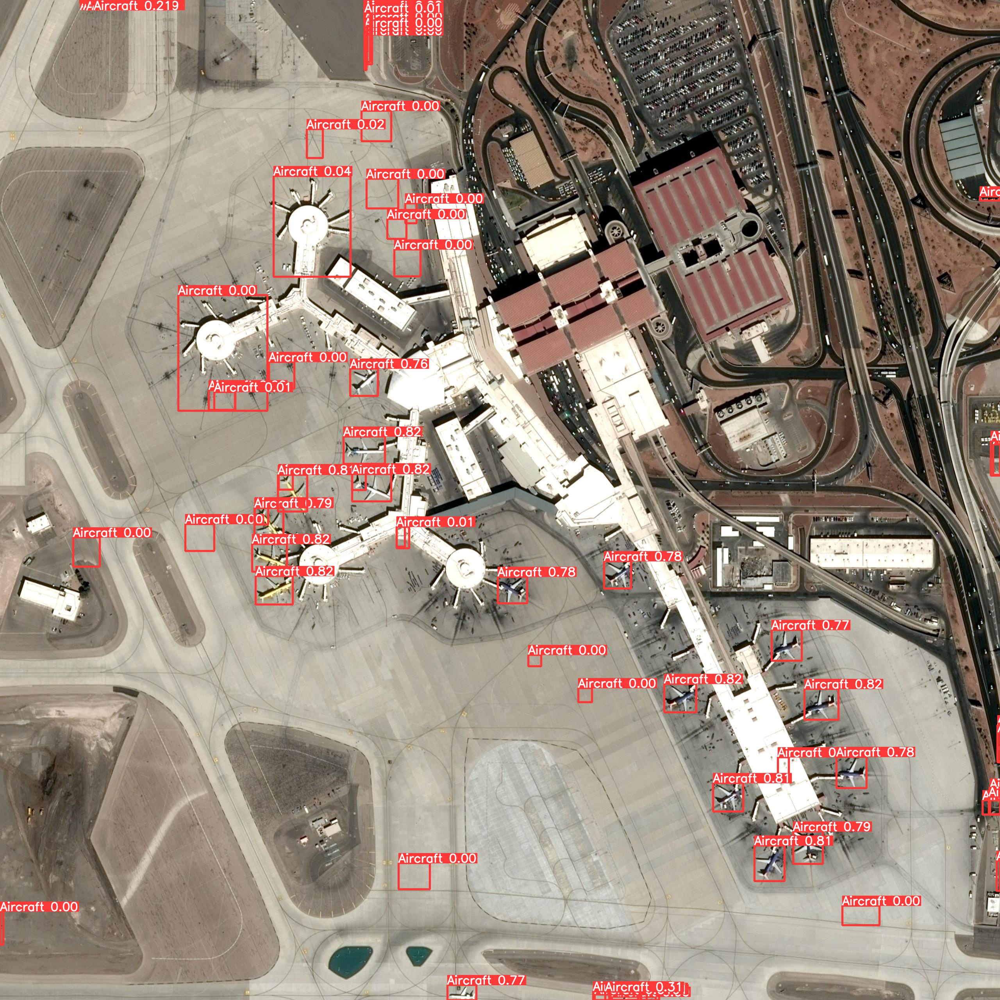

In [6]:
image_path = 'yolov8/detect/test_predictions/65e32857-71dc-406b-8583-1ea6467a330f.jpg'
image = Image.open(image_path)
display(image)

Under the low test confidence threshold of 0.001, the model is able to detect all of the aircraft found in the image above, including partially hidden ones. The model is also erroneously detecting background features such as aerobridges, gates, and even random ground spots, albeit with very very low confidence. The right confidence threshold thus has to be set when doing detections using the model.

## Setting an Appropriate Confidence Threshold

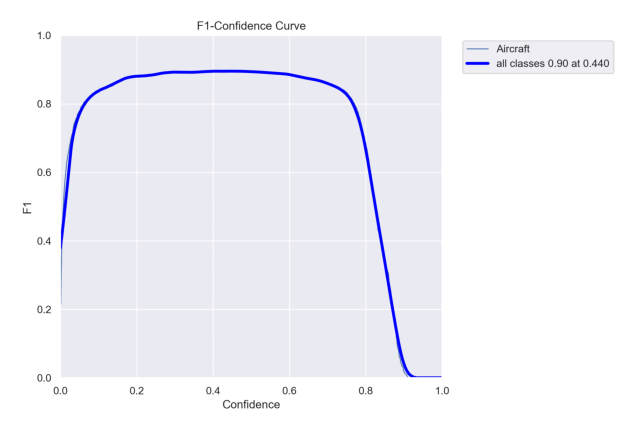

In [7]:
f1_path = 'yolov8/train/F1_curve.png'
f1 = Image.open(f1_path)
plt.figure(figsize=(8,8), frameon=False)
plt.axis('off')
plt.imshow(f1)

We'll be using the F1 score to inform our choice of confidence threshold for detection using the final model, since the F1 score strikes a balance between both precision and recall. As such, the selected confidence threshold will be 0.440 or 44 for the maximum F1 of 0.90. We will be using extra, unseen images provided in the Airbus Dataset for sample detection.

## Extra Detections

In [8]:
test_detect = model(source='data/extras/', imgsz=2560, show=True, save_txt=True, save_conf=True, conf=0.440, save=True, project='yolov8')  # predict on an image

Ultralytics YOLOv8.0.18  Python-3.9.13 torch-1.11.0+cu113 CUDA:0 (NVIDIA GeForce RTX 2060 SUPER, 8192MiB)
Model summary (fused): 268 layers, 43607379 parameters, 0 gradients, 164.8 GFLOPs
Results saved to yolov8\predict2
6 labels saved to yolov8\predict2\labels


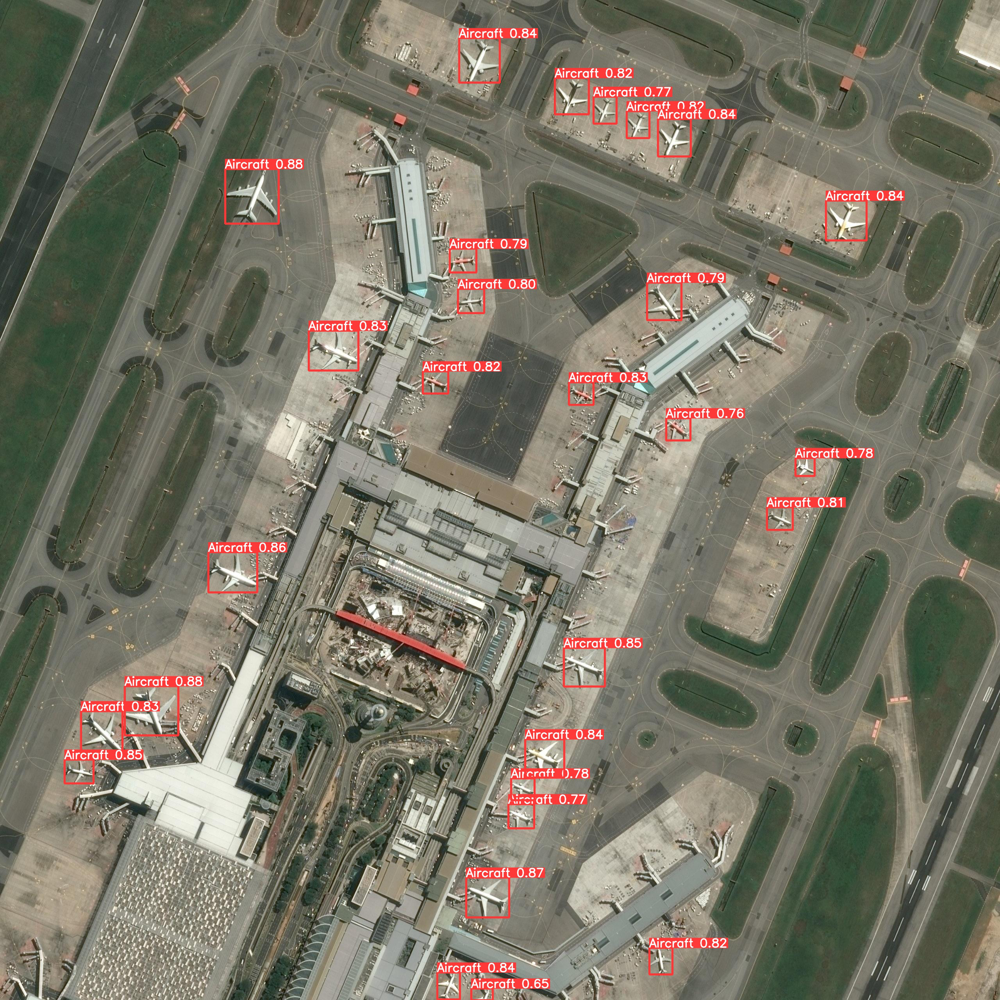

In [9]:
image_path = 'yolov8/predict/08a8132a-a6c7-4cab-adee-7e2976fd2822.jpg'
image = Image.open(image_path)
display(image)

The model is comfortable detecting all the aircraft present on this satellite image, even the truncated aircraft at the bottom that might be difficult for humans to spot.

### SINGAPORE!
Let's make a detection on a Google Earth image of Changi Airport.

In [14]:
test_detect = model(source='data/google_earth/', imgsz=1920, save_txt=True, save_conf=True, conf=0.440, save=True, project='yolov8')

Results saved to yolov8\predict2
8 labels saved to yolov8\predict2\labels


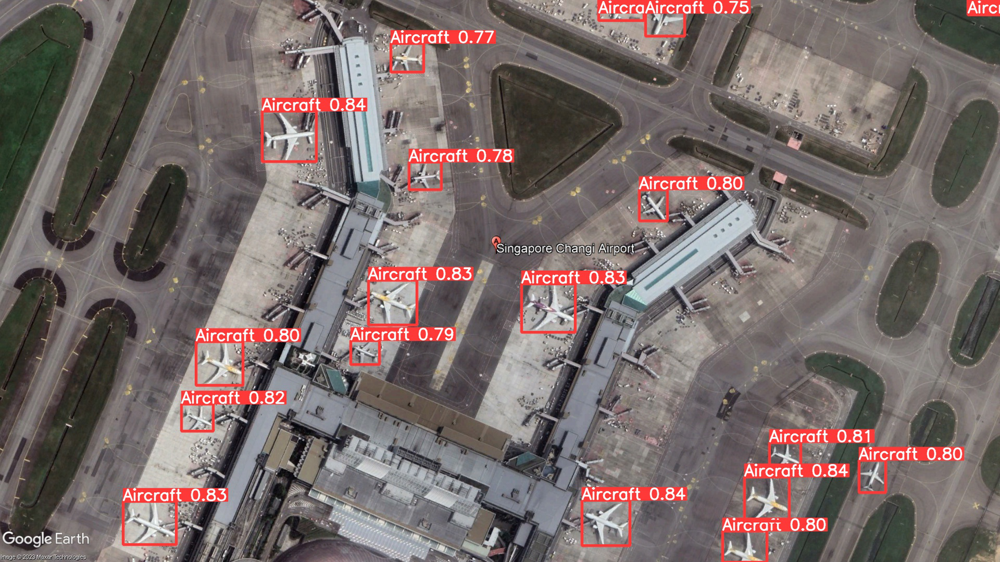

In [15]:
image_path = 'yolov8/predict/changi google maps 250123.jpg'
image = Image.open(image_path)
display(image)

## Conclusions
### Model
1. The final YOLOv8 custom model is capable of detecting airplanes from satellite images with little to no noise under the right confidence threshold settings. In fact, none of the sample dectections had any erroneous or missed detections.
2. The selected model has also met the target mAP stipulated at the start of the project.
3. Besides partial aircraft targets, the model is generally able to detect aircraft with >0.75 confidence.
### Concept
The idea of being able to visually observe airport capacity and movement was well received by the small sample of initial 'testers'. Comments received are that while it is useful to see the number of aircraft parked but it might not translate directly to activity on that very same day. Since we will not be able to monitor activity 24/7 via live feed, there were also concerns about how indicative these trends might be. A counter argument would be that the data obtained might serve as proxies that, when combined with flight plan data, could be better indicators of upcoming activity.
Advantages over present methods include: 
1. No need to rely purely on fallible human memory or information distortion/loss (remember that childhood broken telephone game?).  
2. Avoiding cognitive biases using objective data. Hard numbers vs emotional storytelling (especially when money is being burnt on the ground).   
3. The data obtained can also be archived for other uses down the road.
Ultimately though, the suitability of such a solution is also determined by the ability to obtain relevant live satellite feeds.

## Limitations & Drawbacks
**1. Cost of satellite tasking and imagery vs cost of simply flying.**  
Satellite tasking isn't the cheapest of solutions, although this is mitigated by time potentially spent stuck on the ground (Upwards of $550/hr for training flights) and having to be at the airport. The consideration here would be human effort vs cost of automation.  

**2. Weather**  
Weather over the airfield would block satellite imaging, although this could also be an opportunity to visually capture cloud cover and other weather trends which are important considerations for flying under visual flight rules (VFR).

**3. Quantity and Quality of Training Data**  
More images with a greater variety of airfields, backgrounds and aircraft types would definitely aid in increasing the model's ability to detect aircraft in novel environments, such as over large water bodies or flying in forested training areas.

## Future Directions
As it stands, more features, such as a dashboard for easy monitoring, needs to be built on top of this model before it can be put into production for its desired use case but the model itself can be used in several other situations as well. An extension to this project in the pipeline would be to recognize, differentiate and detect military aircraft in addition to civil ones for ntelligence applications. This would also extend its suitability in being adapted for an aerodrome like Changi where there is military traffic too. While ground-based monitoring capabilities (such as radar, MLAT, ADS-B) are robust, brings a fresh perspective and is intuitively easier to make sense of. Being able to visually pick out potential hot spots or high traffic clusters may help in informing aircraft maneuvering area processes and utilization for greater safety and efficiency.

On that note, an aircraft parking facility such as Asia Pacific Aircraft Storage in Alice Springs, Australia, could employ a similar satellite-based solution for monitoring capacity. At time of writing, these further developments would still require careful consultation with data providers to determine the feasibility of such a project subject to the exact capabilities of currently available satellite constellations. To end off, here is a sample video on SkySat's video capability SkySat Video of Dubai, United Arab Emirates - YouTube.

Credits:  
The Airbus Aircraft Detection Dataset a is licensed under the Creative Commons BY-NC-SA 4.0 International license:
https://creativecommons.org/licenses/by-nc-sa/4.0/ and was obtained from https://www.kaggle.com/datasets/airbusgeo/airbus-aircrafts-sample-dataset